### Import Libraries

In [3]:
import pandas as pd
import numpy as np
import warnings
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance
warnings.filterwarnings('ignore')

In [2]:
from ydata_profiling import ProfileReport

### Read Data

In [4]:
movie = pd.read_csv("movie_metadata.csv")

In [4]:
movie.head()

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0


In [5]:
movie.dtypes

color                         object
director_name                 object
num_critic_for_reviews       float64
duration                     float64
director_facebook_likes      float64
actor_3_facebook_likes       float64
actor_2_name                  object
actor_1_facebook_likes       float64
gross                        float64
genres                        object
actor_1_name                  object
movie_title                   object
num_voted_users                int64
cast_total_facebook_likes      int64
actor_3_name                  object
facenumber_in_poster         float64
plot_keywords                 object
movie_imdb_link               object
num_user_for_reviews         float64
language                      object
country                       object
content_rating                object
budget                       float64
title_year                   float64
actor_2_facebook_likes       float64
imdb_score                   float64
aspect_ratio                 float64
m

### Exploratory Data Analysis

In [6]:
profile = ProfileReport(movie, title = "Movie Ratings Report")

In [7]:
profile.to_file("movie_ratings_metadata_profile.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
profile

### Examine and Remove Observations with missing values

In [5]:
# Report missing values
print(movie.isnull().sum())

color                         19
director_name                104
num_critic_for_reviews        50
duration                      15
director_facebook_likes      104
actor_3_facebook_likes        23
actor_2_name                  13
actor_1_facebook_likes         7
gross                        884
genres                         0
actor_1_name                   7
movie_title                    0
num_voted_users                0
cast_total_facebook_likes      0
actor_3_name                  23
facenumber_in_poster          13
plot_keywords                153
movie_imdb_link                0
num_user_for_reviews          21
language                      12
country                        5
content_rating               303
budget                       492
title_year                   108
actor_2_facebook_likes        13
imdb_score                     0
aspect_ratio                 329
movie_facebook_likes           0
dtype: int64


In [10]:
# Drop columns with missing values
movie = movie.dropna()

### Check and Drop Duplicates

In [11]:
# Check for duplicates
print(movie.duplicated().sum())

33


In [12]:
# Remove duplicates
movie = movie.drop_duplicates()

### Examine Categorical Variables

In [13]:
# Check for categorical columns
for col in movie.columns:
    if movie[col].dtype == "object":
        print(col)

color
director_name
actor_2_name
genres
actor_1_name
movie_title
actor_3_name
plot_keywords
movie_imdb_link
language
country
content_rating


### Identify and Exclude Highly Correlated Features

In [15]:
# Check correlation between variables
correlation_matrix = X.corr()

# Create a mask for highly correlated features
threshold = 0.8  # Set your correlation threshold here
correlation_mask = abs(correlation_matrix) > threshold

# Identify highly correlated pairs
correlation_pairs = []
for i in range(len(correlation_matrix.columns)):
    for j in range(i + 1, len(correlation_matrix.columns)):
        if correlation_mask.iloc[i, j]:
            correlation_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j]))

print("Highly correlated feature pairs:")
for feature1, feature2 in correlation_pairs:
    print(f"{feature1} - {feature2}")

Highly correlated feature pairs:
actor_1_facebook_likes - cast_total_facebook_likes


In [16]:
# Remove one of each correlated pair
filtered_features = set()
for feature1, feature2 in correlation_pairs:
    if feature1 in filtered_features or feature2 in filtered_features:
        continue
    filtered_features.add(feature2)

# Drop highly correlated features from X
X_filtered = X.drop(columns=filtered_features)

### Define Features and Targets and Training Test Split

In [14]:
# Extract features and target variable
X = movie.drop("imdb_score", axis=1)
y = movie["imdb_score"]

In [17]:
# Split the data into training and testing sets (70-30)
X_train, X_test, y_train, y_test = train_test_split(X_filtered, y, test_size=0.3, random_state=42)

### Create Transformers for Numerical and Categorical Features

In [18]:
# Define numerical and categorical features
numerical_features = X_filtered.select_dtypes(include=[np.number]).columns.tolist()
categorical_features = X_filtered.select_dtypes(include=[object]).columns.tolist()

In [19]:
numerical_features

['num_critic_for_reviews',
 'duration',
 'director_facebook_likes',
 'actor_3_facebook_likes',
 'actor_1_facebook_likes',
 'gross',
 'num_voted_users',
 'facenumber_in_poster',
 'num_user_for_reviews',
 'budget',
 'title_year',
 'actor_2_facebook_likes',
 'aspect_ratio',
 'movie_facebook_likes']

In [20]:
categorical_features

['color',
 'director_name',
 'actor_2_name',
 'genres',
 'actor_1_name',
 'movie_title',
 'actor_3_name',
 'plot_keywords',
 'movie_imdb_link',
 'language',
 'country',
 'content_rating']

In [21]:
# Preprocessing: Create transformers for numerical and categorical features
numeric_transformer = Pipeline(steps=[('scaler', StandardScaler())])
categorical_transformer = Pipeline(steps=[('onehot', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numerical_features),
        ('cat', categorical_transformer, categorical_features)
    ])


### Define Regressor Models

In [22]:
# Define models
models = {
    "KNN": KNeighborsRegressor(),
    "Random Forest": RandomForestRegressor(),
    "Gradient Boosting": GradientBoostingRegressor()
}

### Define Hyperparameters

In [23]:
param_grids = {
    "KNN": {
        "model__n_neighbors": [3, 5, 7],
        "model__weights": ['uniform', 'distance'],
        "model__p": [1, 2]  # Manhattan or Euclidean distance
    },
    "Random Forest": {
        "model__n_estimators": [50, 100],
        "model__max_depth": [None, 10, 20],
        "model__min_samples_split": [2, 5, 10],
        "model__min_samples_leaf": [1, 2, 4],
        "model__max_features": ['auto', 'sqrt', 'log2']
    },
    "Gradient Boosting": {
        "model__n_estimators": [50, 100],
        "model__learning_rate": [0.01, 0.1, 0.2],
        "model__max_depth": [3, 5, 7],
        "model__subsample": [0.8, 0.9, 1.0],  # Fraction of samples used for fitting trees
        "model__min_samples_split": [2, 5, 10]
    }
}

### Model Training and Identifying best Hyperparameters

In [24]:
best_models = {}
for model_name, model in models.items():
    pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('model', model)])
    param_grid = param_grids[model_name]
    grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='neg_mean_squared_error')
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    best_models[model_name] = best_model

In [27]:
best_models

{'KNN': Pipeline(steps=[('preprocessor',
                  ColumnTransformer(transformers=[('num',
                                                   Pipeline(steps=[('scaler',
                                                                    StandardScaler())]),
                                                   ['num_critic_for_reviews',
                                                    'duration',
                                                    'director_facebook_likes',
                                                    'actor_3_facebook_likes',
                                                    'actor_1_facebook_likes',
                                                    'gross', 'num_voted_users',
                                                    'facenumber_in_poster',
                                                    'num_user_for_reviews',
                                                    'budget', 'title_year',
                                                 

### Model Evaluation and Selection

In [43]:
eval_results = {}
for model_name, model in best_models.items():
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    r2 = r2_score(y_test, y_pred)
    eval_results[model_name] = (rmse, r2)

In [44]:
eval_results

{'KNN': (0.7840421122484241, 0.41734869020343013),
 'Random Forest': (0.7786071384830014, 0.42539856095104045),
 'Gradient Boosting': (0.6491993643125581, 0.6005282070213074)}

In [45]:
%matplotlib inline
import matplotlib.pyplot as plt

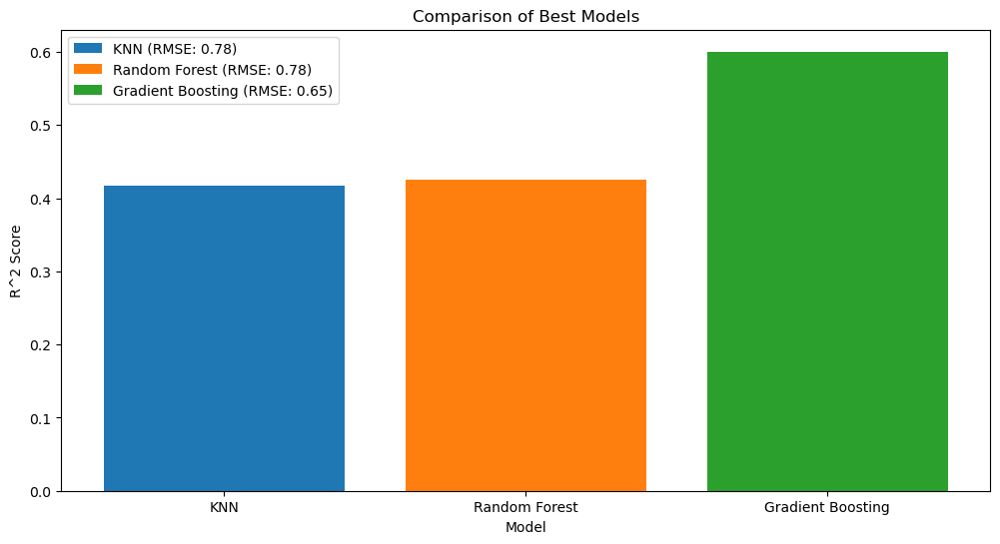

In [46]:
# Plot metrics for best models
plt.figure(figsize=(12, 6))
for model_name, (rmse, r2) in eval_results.items():
    plt.bar(model_name, r2, label=f'{model_name} (RMSE: {rmse:.2f})')
plt.xlabel('Model')
plt.ylabel('R^2 Score')
plt.title('Comparison of Best Models')
plt.legend()
plt.show()

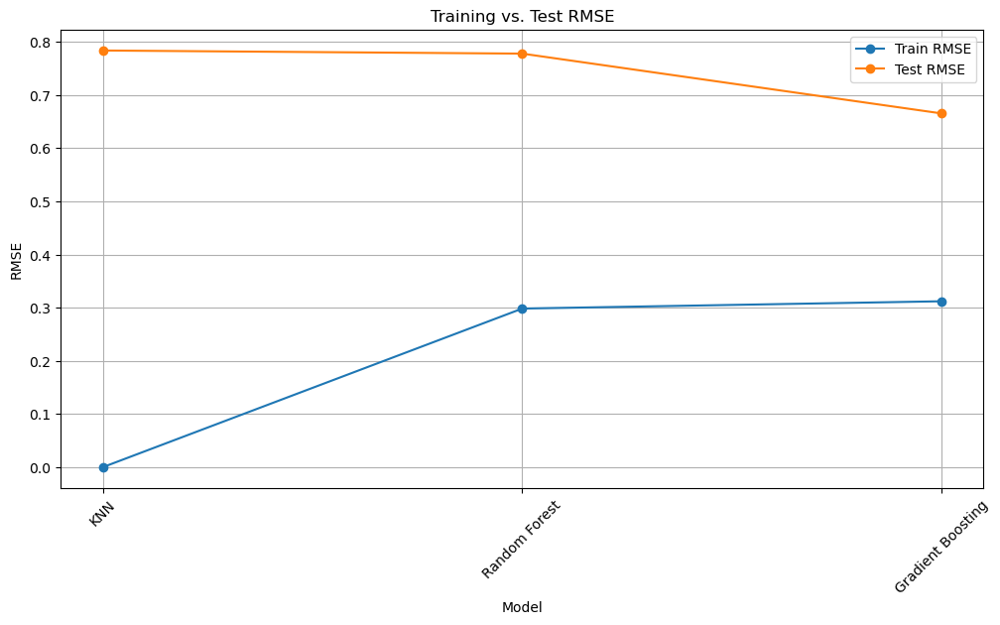

In [47]:
# Train and evaluate models
eval_results = {}
train_rmse_values = []
test_rmse_values = []

for model_name, model in best_models.items():
    model.fit(X_train, y_train)  # Fit on the training data
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
    rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred))
    
    eval_results[model_name] = (rmse_train, rmse_test)
    train_rmse_values.append(rmse_train)
    test_rmse_values.append(rmse_test)

# Plot training vs. test results as a line graph
plt.figure(figsize=(12, 6))
x_labels = list(eval_results.keys())

plt.plot(x_labels, train_rmse_values, marker='o', label='Train RMSE')
plt.plot(x_labels, test_rmse_values, marker='o', label='Test RMSE')

plt.xlabel('Model')
plt.ylabel('RMSE')
plt.title('Training vs. Test RMSE')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

### Selected Model

In [80]:
selected_model_name = "Gradient Boosting"
selected_model = models[selected_model_name]
selected_model

GradientBoostingRegressor()